# Analyse der Tweets von Bundestagsabgeordneten
## 1. Dataset preparation

In [1]:
import pymongo

client = pymongo.MongoClient("mongodb://localhost:27017/")

db = client['Twitter']
All_Tweets_collection = db['twitter_mdp_ex_date_proj']


In [2]:
import pandas as pd
import pymongo
import datetime

pd.set_option('display.max_colwidth', 0)

# sample_df = pd.DataFrame(list(All_Tweets_collection.aggregate([ {"$sample": {"size": 50 }}], 
#                                      allowDiskUse=True
#                                    )))

time_sample_df = pd.DataFrame(list(All_Tweets_collection.find( {
            'created_at_datetime': {'$gte': datetime.datetime(2017,1,1,0,0,0),
                                    '$lt': datetime.datetime(2020,5,31,0,0,0)},
            'retweeted_id': None
            })
        ))

In [3]:
time_sample_df = time_sample_df.drop(['partei'], axis=1)
time_sample_df.head(2)

,_id,created_at,id,full_text,is_quote_status,retweet_count,lang,created_at_datetime,user_id,user_name,user_screen_name,user_location,user_description,user_followers_count,user_friends_count,user_created_at,user_party
0,5e954cff7973ce357347fb0f,Fri Feb 22 15:10:38 +0000 2019,1098963281329438720,Alles schon geregelt https://t.co/rPsmex9emf,True,0,de,2019-02-22 15:10:38,1098889251515703296,BystronAFD,AfdBystron,,Satire Account,9,41,Fri Feb 22 10:16:28 +0000 2019,AFD
1,5e954cff7973ce357347fb1c,Fri Feb 22 14:37:27 +0000 2019,1098954928960274432,Herr Schneider es sind 11% und wer hat bisher in der CDU das sagen gehabt? Eine Frau! Jetzt müssen wieder gestandene Männer an die Macht! Die AFD wird das 2020 machen https://t.co/96pGx1vZNw,True,0,de,2019-02-22 14:37:27,1098889251515703296,BystronAFD,AfdBystron,,Satire Account,9,41,Fri Feb 22 10:16:28 +0000 2019,AFD


In [26]:
%%html
<style>
table {float:left}
</style>

## Übersicht der Tweets pro Partei 

Gibt es Namen die keiner Partei zugeordnet werden konnten?
* AfdBystron - Satire Account
* EspendillerM - Name geändert wegen Dr. Titel

*Müssen bei nächstem Datenbank- Update angepasst werden*


##### Beispiel für die Übersicht für Tweets im Zeitraum 01.01.2019 - 10.05.2020

|Partei  |  Tweets |      |mdp gesamt|mdp Twitter|Anteil Twitter user|Tweets pro user
|--------|---------|      |----------|-----------|----------|---------------
|AFD     |  12959  |      |89        |26         |29,21     |498
|FDP     |  47759  |      |80        |69         |86,25     |692
|Gruene  |  39910  |      |67        |57         |85,07     |700
|Linke   |  36422  |      |69        |49         |71,01     |743
|SPD     |  44520  |      |152       |102        |67,11     |436
|Union   |  39979  |      |246       |122        |49,59     |328


##### Entferne Tweets ohne Parteizuordnung

Nach der Überarbeitung der Namenslisten (manuelle Suche auf Twitter), wurden die folgenden "Namen" aus Listen entfernt, für die jedoch Tweets in der Datenbank stehen.

* AfdBystron       -- aus mongodb entfernen
* cducsubt         -- aus mongodb entfernen
* fdpbt            -- aus mongodb entfernen
* kahrs            -- Collection "parteizuordnung" um diesen Politiker + Partei ergänzen
* BabettesChefin   -- aus mongodb entfernen ("twittert nicht mehr. „Nicht meine Politik-Kommunikation!“)
* ruppert_stefan   -- Collection "parteizuordnung" um diesen Politiker + Partei ergänzen
* PetrBystronAfD   -- Muss in normale Liste mit aufgenommen werden! (== aktueller Account)
* EspendillerM     -- Collection "parteizuordnung" um diesen Politiker + Partei ergänzen

In [4]:
# no_party = time_sample_df[time_sample_df.user_party.isnull()].user_screen_name
# for i in set(no_party):
#     print(i)

sample_df = time_sample_df[time_sample_df.user_party.isnull()== False]
len(sample_df['user_screen_name'])

410898

#### Unterteilung in Bins und erstellen eines Dictionarys für Zeiträume

In [5]:
# Sortieren nach Datum/Zeit
sample_df = sample_df.sort_values(by = ['created_at_datetime'])

# Zerschneiden in Bins
sample_df['bins'] = pd.cut(sample_df['created_at_datetime'], bins=70, labels=list(range(1,71)))

labels=list(range(1,71))
weeks = {}
    
for i in labels:
    weeks['week_'+str(i)] = sample_df[sample_df['bins'] == i]    

bin_sum_per_week = {}

for label in range(1,71): 
    df = sample_df[sample_df['bins'] == label]
    head = list(df.created_at_datetime.head(1))[0]
    tail = list(df.created_at_datetime.tail(1))[0]
    bin_sum_per_week[label] = {}
    bin_sum_per_week[label]['Von'] = head
    bin_sum_per_week[label]['Bis'] = tail
bin_sum_per_week


{1: {'Von': Timestamp('2017-01-01 00:42:42'),
  'Bis': Timestamp('2017-01-18 19:49:36')},
 2: {'Von': Timestamp('2017-01-18 19:56:21'),
  'Bis': Timestamp('2017-02-05 14:38:49')},
 3: {'Von': Timestamp('2017-02-05 15:18:59'),
  'Bis': Timestamp('2017-02-23 10:13:33')},
 4: {'Von': Timestamp('2017-02-23 10:18:32'),
  'Bis': Timestamp('2017-03-12 23:00:17')},
 5: {'Von': Timestamp('2017-03-13 07:00:01'),
  'Bis': Timestamp('2017-03-30 22:52:56')},
 6: {'Von': Timestamp('2017-03-31 02:42:24'),
  'Bis': Timestamp('2017-04-17 19:47:47')},
 7: {'Von': Timestamp('2017-04-17 20:40:08'),
  'Bis': Timestamp('2017-05-05 14:55:37')},
 8: {'Von': Timestamp('2017-05-05 15:14:01'),
  'Bis': Timestamp('2017-05-23 10:12:17')},
 9: {'Von': Timestamp('2017-05-23 10:13:05'),
  'Bis': Timestamp('2017-06-10 03:45:55')},
 10: {'Von': Timestamp('2017-06-10 05:48:22'),
  'Bis': Timestamp('2017-06-28 00:30:04')},
 11: {'Von': Timestamp('2017-06-28 00:43:06'),
  'Bis': Timestamp('2017-07-15 19:09:14')},
 12: {'V

#### Erstellen eines Dictionary für Parteizugehörikgeit

In [6]:
partei_dic = {}
parteien = ['Union', 'SPD', 'Gruene', 'Linke', 'FDP', 'AFD']

for partei in parteien:
    partei_dic['tweets_'+ partei] = sample_df[sample_df['user_party'] == partei]  

# Explorative Daten Analyse (EDA) - nach Partei gegliedert
## 1.) Allgemeine Übersicht
##### Eingrenzung der relevanten Spalten

In [7]:
mdp_tweets = sample_df[['created_at_datetime','user_screen_name','user_party', 'full_text']]
mdp_tweets.tail()

,created_at_datetime,user_screen_name,user_party,full_text
417451,2020-05-30 23:09:46,LieblingXhain,Gruene,"@AndreNeumannABG Lesen bildet : https://t.co/lB7w7Wckrv Danach sollten Sie Ihren Tweet nochmals betrachten und sich fragen, ob Sie es so stehen lassen wollen. Und vielleicht schalten Sie nicht nur den Verstand, sondern auch das Herz ein zum Zwecke der Herzensbildung #rassismustoetet"
288443,2020-05-30 23:26:42,Karl_Lauterbach,SPD,"Sieht tatsächlich so aus, als wenn R-Wert langsam steige. Zu viele denken, Spuk sei vorüber. Davon kann leider keine Rede sein. Stimmung ist besser als die Lage. MPs sind jetzt „in charge“ und sollten zu mehr Vorsicht mahnen statt der Lockerungswettkämpfe https://t.co/BmH2rQkiwP"
280965,2020-05-30 23:26:56,GtzFrmming,AFD,"@heutejournal Eben. Damals. Meines Wissens wird nicht die Monarchie wieder hergestellt, sondern ein historisches Gebäude. Vor einem christlichen Kreuz muss niemand Angst haben."
315990,2020-05-30 23:34:36,Renner_AfD,AFD,"So wird deutlich, wie epochal unverfroren #Merkel im Zwangsgebühren-TV gehuldigt wird und Kritiker als Wirrköpfe und Spinner verunglimpft werden, denen gesagt sein muss: „… dass es keine Normalität, wie vorher, mehr geben werde“... https://t.co/5ezhdvByjC https://t.co/ab7RUjvuIt"
305906,2020-05-30 23:47:42,oezoguz,SPD,"@ParentsmagazinH Ach wie nett. Das ist ja immer lustig, wenn man sich so unerwartet trifft ."


##### Eingrenzung der relevanten Zeilen

In [13]:
# mdp_tweets = mdp_tweets.loc[(mdp_tweets['created_at_datetime'] < datetime.datetime(2020,1,1,0,0,0)) & (mdp_tweets['created_at_datetime'] >= datetime.datetime(2019,1,1,0,0,0))]


##### Betrachtung auf Tagesebene und Wochenebene 

In [32]:
date = []
for timestamp in mdp_tweets.created_at_datetime:
    date.append(timestamp.date())
      
mdp_tweets['date'] = date
print(mdp_tweets['date'])


160213    2017-01-01
204397    2017-01-01
98687     2017-01-01
334061    2017-01-01
107580    2017-01-01
             ...    
379458    2020-06-03
372432    2020-06-03
383807    2020-06-03
409775    2020-06-03
420776    2020-06-03
Name: date, Length: 412166, dtype: object


/usr/local/anaconda3/bin/ipython:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [33]:
# mdp_tweets['week'] = mdp_tweets.created_at_datetime.dt.weekofyear
# mdp_tweets

mdp_tweets['month'] = mdp_tweets.created_at_datetime.dt.strftime('%y-%m')

# mdp_tweets['week'] = mdp_tweets.created_at_datetime.dt.strftime('%y-w%V')
mdp_tweets.tail()

/usr/local/anaconda3/bin/ipython:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import re


,created_at_datetime,user_screen_name,user_party,full_text,date,month
379458,2020-06-03 09:44:42,lisapaus,Gruene,@fuchsgruen @KlaraSche @HinrichWe War wie immer schön mit Euch :-) 👏👏👏,2020-06-03,20-06
372432,2020-06-03 09:47:17,christianduerr,FDP,"Wer Millionen Muslime im eigenen Land einsperrt, sollte sich mit Ratschlägen zu Menschenrechten zurückhalten. https://t.co/bFAaCQfj7i",2020-06-03,20-06
383807,2020-06-03 09:49:34,HoffmannForest,FDP,Italienische Corona App läuft sogar auf Deutsch. Die aus ihrer CDU /SPD Bundesregierung nicht. Zu lahm! https://t.co/VkqvFGQpi9 https://t.co/nTbp5CqcSy,2020-06-03,20-06
409775,2020-06-03 09:52:43,johannesvogel,FDP,"Im China der KP wäre es undenkbar, dass Bilder der Demonstrationen überhaupt im TV liefen, in den USA wird offen über den Präsidenten &amp; sein Agieren diskutiert. Der Westen ist wahrlich nicht perfekt, und das quält uns alle - aber der Unterschied könnte nicht fundamentaler sein! https://t.co/wfmnvZrxYv",2020-06-03,20-06
420776,2020-06-03 11:02:01,katjadoerner,Gruene,"Nächsten Mittwoch von 10 bis 12 Uhr bin ich wieder für die Bonnerinnen und Bonner zu sprechen, per Videoschalte oder Telefon. Anmeldungen bitte über katja.doerner.wk@bundestag.de https://t.co/BebJqMNv2n",2020-06-03,20-06


##### Pivotierung
* Wie viel hat welche Partei an welchem Tag getwittert?
* Wie viel haben die Mitglieder einer Partei in best. Zeiraum getwittert?
* Wie viel hat ein best Mitglied an welchem Tag getwittert?

In [34]:
import numpy as np
mdp_partei = mdp_tweets[['user_party', 'date', 'month', 'user_screen_name', 'full_text']]
partei_piv = pd.pivot_table(mdp_partei, columns = ['user_party'], index = ['month'], aggfunc = np.count_nonzero)
partei_piv['full_text'].tail()
# partei_Piv = partei_piv['full_text']
# partei_Piv.groupby('week').sum()

user_party,AFD,FDP,Gruene,Linke,SPD,Union
month,,,,,,
20-02,2373,3363,2809,3046,3485,2599
20-03,2238,4199,3719,3569,3817,3305
20-04,1618,3815,3129,2866,3106,2575
20-05,1806,3549,2924,1902,3062,3369
20-06,128,206,151,96,196,149


In [35]:
partei_piv_dic = {}

for partei in parteien:
    partei_mdp = mdp_tweets[mdp_tweets['user_party'] == partei]
    patei_names = partei_mdp[['user_screen_name', 'date']]
    partei_piv_dic[partei] = pd.pivot_table(patei_names, index = 'user_screen_name', aggfunc = np.count_nonzero )
    
partei_piv_dic['Gruene'].head()

,date
user_screen_name,
ABaerbock,939
BeateWaRo,504
BriHasselmann,1898
ChrisKuehn_mdb,651
DJanecek,2143


In [36]:
name_piv_dic = {}
    
for partei in parteien:
    partei_mdp = mdp_tweets[mdp_tweets['user_party'] == partei]
    partei_names = partei_mdp[['user_screen_name', 'date']]
    for name in set(partei_names['user_screen_name']):
        name_piv = pd.pivot_table(partei_names[partei_names['user_screen_name'] == name], index = 'date', aggfunc = np.count_nonzero)
        name_piv_dic[name] = name_piv

In [38]:
# name_piv_dic['StBrandner'].head(5)

### Erstelle Übersichtstabelle 

In [39]:
mdp_gesamt = [246, 152, 67, 69, 80, 89] # https://www.bundestag.de/parlament/plenum/sitzverteilung_19wp

tweets_piv = pd.pivot_table(mdp_partei, index = 'user_party', aggfunc = np.count_nonzero )['full_text']
Tweets = []
for partei in parteien:
    Tweets.append(tweets_piv[partei])

mdp_Twitter = []
for partei in parteien:
    mdp_Twitter.append(len(partei_piv_dic[partei]))

summary_df = pd.DataFrame({'user_party':parteien, 'Tweets': Tweets, 'mdp_gesamt': mdp_gesamt, 'mdp_Twitter': mdp_Twitter})
summary_df['Anteil_Twitter_user'] = round(summary_df['mdp_Twitter']/summary_df['mdp_gesamt']*100, 2)
summary_df['Tweets_pro_user'] = round(summary_df['Tweets']/summary_df['mdp_Twitter'])
summary_df.index = summary_df['user_party']
summary_df = summary_df.drop(columns = 'user_party')
summary_df


,Tweets,mdp_gesamt,mdp_Twitter,Anteil_Twitter_user,Tweets_pro_user
user_party,,,,,
Union,73655,246,136,55.28,542.0
SPD,86843,152,115,75.66,755.0
Gruene,74482,67,60,89.55,1241.0
Linke,63629,69,51,73.91,1248.0
FDP,67310,80,74,92.50,910.0
AFD,46247,89,76,85.39,609.0


In [194]:
# #name_piv_dic['StBrandner'][name_piv_dic['StBrandner'].index == datetime.date(2020,2,6)]
# for tweet in mdp_partei.index:
#     if((mdp_partei['user_screen_name'][tweet] == 'StBrandner') and mdp_partei['date'][tweet] == datetime.date(2020,5,3)):
#         #print(mdp_partei['date'][tweet])
#         print(mdp_partei['full_text'][tweet])


## 2.) Grafen zur Menge von Tweets über die Zeit

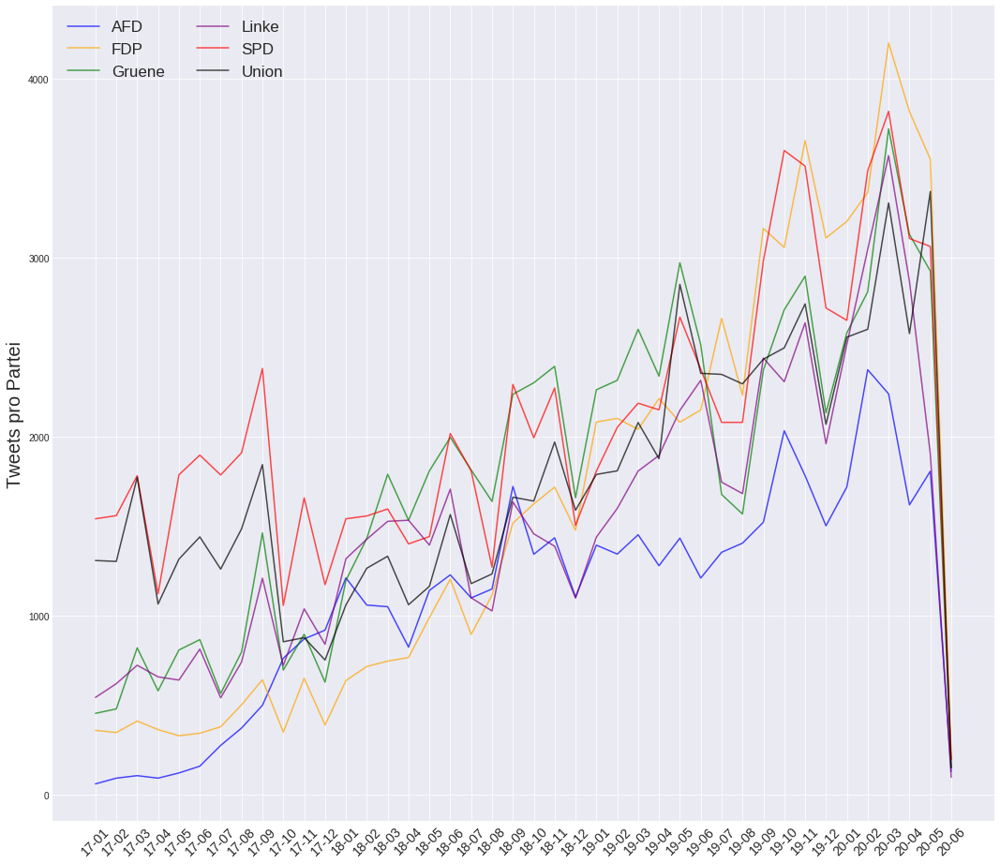

In [40]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd
import numpy as np

plt.style.use('seaborn-darkgrid')
my_palette = ['blue', 'orange', 'green', 'purple', 'red', 'black']

fig = plt.figure(figsize = (18, 16))
ax = fig.add_subplot(111)

num=0
for column in partei_piv['full_text']:
    ax.plot(partei_piv.index, partei_piv['full_text'][column], color = my_palette[num], alpha=0.7, label = column)
    num+=1
    
ylab = ax.set_ylabel('Tweets pro Partei', size = 20)
# = ax.set_xlabel('Datum', size = 20)
plt.legend(loc = 2, ncol = 2, fontsize = 17)

# y_tags
# ytag = ax.set_yticklabels(np.arange(partei_piv.values.min()-51, partei_piv.values.max()+50, 50), fontsize = 18)
# ytag = ax.set_yticklabels(np.arange(partei_piv.values.min()-90, partei_piv.values.max(), 200), fontsize = 18)

#x_tags
xtag = ax.set_xticklabels(partei_piv.index, fontsize = 14, rotation = 45)

# months = mdates.MonthLocator()
# months_fmt = mdates.DateFormatter('%b-%Y')

# ax.xaxis.set_major_locator(months)
# ax.xaxis.set_major_formatter(months_fmt)





## 3.) Einfache Textanalysen
##### Text Cleaning

In [8]:
# Load the regular expression library
pd.set_option('display.max_colwidth', 0)
import re

def remove_emoji(string):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F900-\U0001F9FF"  # https://www.compart.com/de/unicode/block/U+1F900
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', string)


# Remove punctuation
sample_df['full_text_processed'] = sample_df['full_text'].map(lambda x: re.sub('[,\.!?#@\\n"“„\:;&\(\)]', '', x))
# Remove Links
sample_df['full_text_processed'] = sample_df['full_text_processed'].map(lambda x: re.sub('http.*', '', x))

sample_df['full_text_processed'] = sample_df['full_text_processed'].map(lambda x: re.sub('amp', '', x))
# Convert the titles to lowercase
#sample_df['full_text_processed'] = sample_df['full_text_processed'].map(lambda x: x.lower())

#sample_df['full_text_processed'] = sample_df['full_text_processed'].map(lambda x: remove_emoji(x))
# Print out the first rows of papers
sample_df['full_text_processed'].head(200)

160213    Frohes neues Jahr 2017                                                                                                                  
204397    Hätte gewünscht dass 2017 besser startet als 2016 Istanbul SenyurtSinan Gedanken  bei den Opfern üzgüngece                              
98687     Alles Gute im neuen Jahr Das Wahljahr beginnt für mich um 11 Uhr bei der CDU Korntal im Bürgertreff in der Görlitzstraße Herzl Einladung
333391                                                                                                                                            
107580    Alles Gute im neuen Jahr                                                                                                                
                    ...                                                                                                                           
222786    Interview mit DIENEUE1077 zu Anlaufschwierigkeiten bei der Elektromobilität Das wird schon noch             

##### Durchsuche Datensatz nach bestimmten Tweets und sortiere aus

In [135]:
# Print words that match certain words:
#sample_df['full_text_processed'][sample_df['full_text_processed'].str.match(r'.*brexit.*')==True]

# Remove Tweets that match certain words:
sample_df = sample_df[~sample_df.full_text_processed.str.contains("fröhlicher gruss")]
#time_sample_df.groupby('Partei').size()
#sample_df.groupby('Partei').size()

##### Stopwords

In [9]:
#from stop_words import get_stop_words
#stop_words = get_stop_words('de')

import stopwordsiso as stopwords
stop_words = list(stopwords.stopwords(["de"])) 

mehr_sw = ['der', 'die', 'das', 'Das', 'the', 'ist' 'es', 'gibt', 'und', 'für', 'auf', 'aus', 'mit', 'dem', 'tb', 'cducsubt', 'spdbt', 'fdpbt', 'sdpde']
for word in mehr_sw:
    stop_words.append(word)
    


# Wordclouds
#### Basic

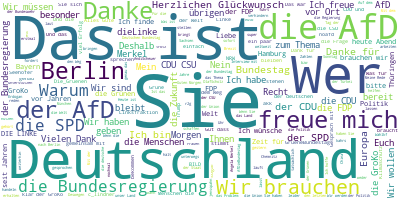

In [50]:
# Import the wordcloud library
from wordcloud import WordCloud

# Join the different processed titles together.
long_string = ','.join(sample_df['full_text_processed'])
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
wordcloud.to_image()

#fig, axs = plt.subplots(1,2)

#df['korisnika'].plot(ax=axs[0])
#df['osiguranika'].plot(ax=axs[1])

#### Wordcloud zu bestimmtem Zeitunkt

(-0.5, 399.5, 199.5, -0.5)

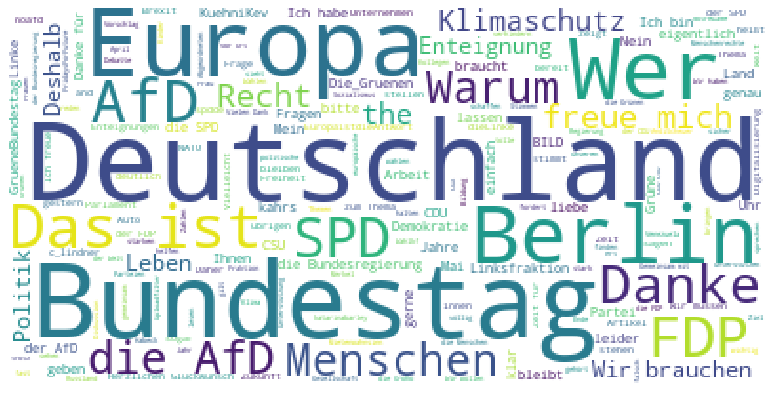

In [117]:
# Import the wordcloud library
from wordcloud import WordCloud

sample_df_date = sample_df[sample_df.created_at_datetime >= datetime.datetime(2020,5,8,0,0,0)]
sample_df_date = sample_df.loc[(sample_df['created_at_datetime'] <= datetime.datetime(2019,5,8,0,0,0)) & (sample_df['created_at_datetime'] >= datetime.datetime(2019,4,1,0,0,0))]

# Join the different processed titles together.
long_string = ','.join(sample_df_date['full_text_processed'])
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=50000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
plt.figure( figsize=(16,7) )
plt.imshow(wordcloud)
plt.axis("off")



### Wöchentliche Wordcloud - Union

Text(0.5, 1.05, 'Union_Tweets')

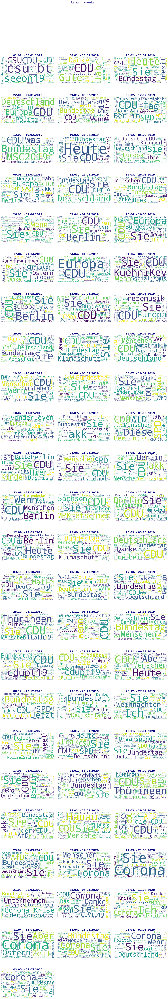

In [146]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'Union'

sample_df_partei = sample_df[sample_df.Partei == party]

date_dic_partei = {}
# for partei in parteien:
#     week_dic_partei['tweets_'+ partei] = date_dic_partei[sample_df['Partei'] == partei]  
    
for week in weeks:
    #date_dic_partei[week + '_' + 'AFD'] = weeks[week].loc("Partei" == 'AFD')
    date_dic_partei[week + '_' + party] = weeks[week].loc[weeks[week].Partei == party]
    #print(weeks[week].loc[weeks[week].Partei == "AFD"])



def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 100))

for i, n in zip(date_dic_partei, range(1,71)):
    title = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
 

    ax = fig.add_subplot(24,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    sample_df_week=date_dic_partei[i]
    long_string = ','.join(sample_df_week['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.05)

### Wöchentliche Wordcloud - AFD

Text(0.5, 1.05, 'AFD_Tweets')

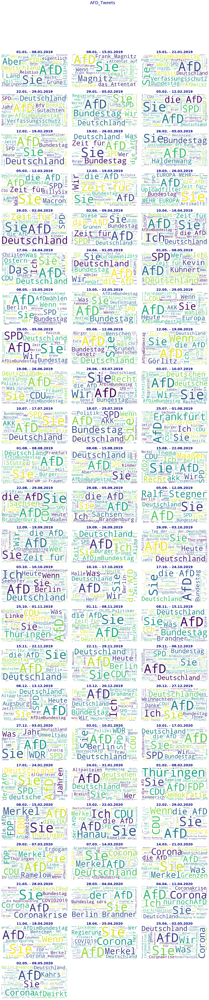

In [150]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'AFD'

sample_df_partei = sample_df[sample_df.Partei == party]

date_dic_partei = {}
# for partei in parteien:
#     week_dic_partei['tweets_'+ partei] = date_dic_partei[sample_df['Partei'] == partei]  
    
for week in weeks:
    #date_dic_partei[week + '_' + 'AFD'] = weeks[week].loc("Partei" == 'AFD')
    date_dic_partei[week + '_' + party] = weeks[week].loc[weeks[week].Partei == party]
    #print(weeks[week].loc[weeks[week].Partei == "AFD"])



def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 100))

for i, n in zip(date_dic_partei, range(1,71)):
    title = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
 

    ax = fig.add_subplot(24,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    sample_df_week=date_dic_partei[i]
    long_string = ','.join(sample_df_week['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.05)

### Wöchentliche Wordcloud - SPD

Text(0.5, 1.05, 'SPD_Tweets')

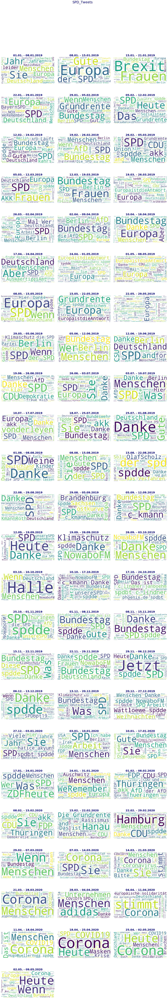

In [149]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'SPD'

sample_df_partei = sample_df[sample_df.Partei == party]

date_dic_partei = {}
# for partei in parteien:
#     week_dic_partei['tweets_'+ partei] = date_dic_partei[sample_df['Partei'] == partei]  
    
for week in weeks:
    #date_dic_partei[week + '_' + 'AFD'] = weeks[week].loc("Partei" == 'AFD')
    date_dic_partei[week + '_' + party] = weeks[week].loc[weeks[week].Partei == party]
    #print(weeks[week].loc[weeks[week].Partei == "AFD"])



def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 100))

for i, n in zip(date_dic_partei, range(1,71)):
    title = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
 

    ax = fig.add_subplot(24,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    sample_df_week=date_dic_partei[i]
    long_string = ','.join(sample_df_week['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.05)

### Wöchentliche Wordcloud - Grüne

Text(0.5, 1.05, 'Gruene_Tweets')

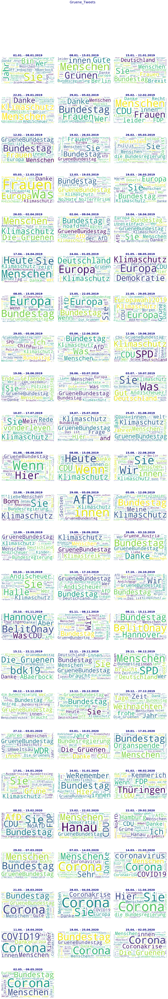

In [147]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'Gruene'

sample_df_partei = sample_df[sample_df.Partei == party]

date_dic_partei = {}
# for partei in parteien:
#     week_dic_partei['tweets_'+ partei] = date_dic_partei[sample_df['Partei'] == partei]  
    
for week in weeks:
    #date_dic_partei[week + '_' + 'AFD'] = weeks[week].loc("Partei" == 'AFD')
    date_dic_partei[week + '_' + party] = weeks[week].loc[weeks[week].Partei == party]
    #print(weeks[week].loc[weeks[week].Partei == "AFD"])



def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 100))

for i, n in zip(date_dic_partei, range(1,71)):
    title = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
 

    ax = fig.add_subplot(24,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    sample_df_week=date_dic_partei[i]
    long_string = ','.join(sample_df_week['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.05)

### Wöchentliche Wordcloud - Linke

Text(0.5, 1.05, 'Gruene_Tweets')

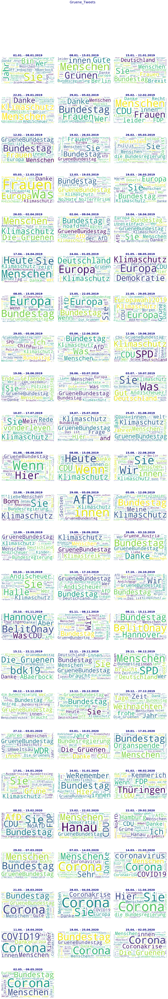

In [147]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'Linke'

sample_df_partei = sample_df[sample_df.Partei == party]

date_dic_partei = {}
# for partei in parteien:
#     week_dic_partei['tweets_'+ partei] = date_dic_partei[sample_df['Partei'] == partei]  
    
for week in weeks:
    #date_dic_partei[week + '_' + 'AFD'] = weeks[week].loc("Partei" == 'AFD')
    date_dic_partei[week + '_' + party] = weeks[week].loc[weeks[week].Partei == party]
    #print(weeks[week].loc[weeks[week].Partei == "AFD"])



def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 100))

for i, n in zip(date_dic_partei, range(1,71)):
    title = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
 

    ax = fig.add_subplot(24,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    sample_df_week=date_dic_partei[i]
    long_string = ','.join(sample_df_week['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.05)

### Wöchentliche Wordcloud - FDP

Text(0.5, 1.05, 'Gruene_Tweets')

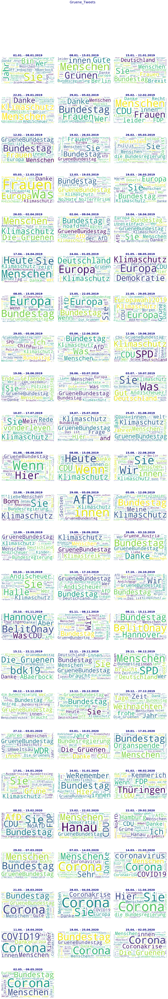

In [147]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'FDP'

sample_df_partei = sample_df[sample_df.Partei == party]

date_dic_partei = {}
# for partei in parteien:
#     week_dic_partei['tweets_'+ partei] = date_dic_partei[sample_df['Partei'] == partei]  
    
for week in weeks:
    #date_dic_partei[week + '_' + 'AFD'] = weeks[week].loc("Partei" == 'AFD')
    date_dic_partei[week + '_' + party] = weeks[week].loc[weeks[week].Partei == party]
    #print(weeks[week].loc[weeks[week].Partei == "AFD"])



def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 100))

for i, n in zip(date_dic_partei, range(1,71)):
    title = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
 

    ax = fig.add_subplot(24,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    sample_df_week=date_dic_partei[i]
    long_string = ','.join(sample_df_week['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.05)

#### Wordcloud Gegenüberstellung von Parteien

/usr/local/anaconda3/bin/ipython:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


Text(0.5, 1.05, 'Tweets 8. Mai ohne Corona')

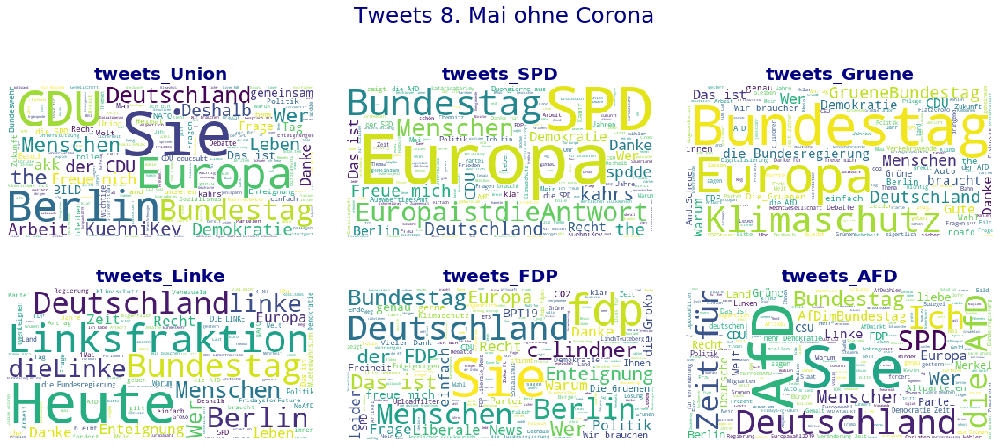

In [118]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud


#sample_df_date = sample_df[sample_df.created_at_datetime >= datetime.datetime(2020,5,8,0,0,0)]
sample_df_date = sample_df.loc[(sample_df['created_at_datetime'] <= datetime.datetime(2019,5,8,0,0,0)) & (sample_df['created_at_datetime'] >= datetime.datetime(2019,4,1,0,0,0))]


partei_dic_date = {}
for partei in parteien:
    partei_dic_date['tweets_'+ partei] = sample_df_date[sample_df['Partei'] == partei]  


def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (16, 16))
#fig.subplots_adjust(top=0.8)

for partei, n in zip(partei_dic_date, range(1,7)):
    title = str(partei)
    
    ax = fig.add_subplot(5,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    sample_df_partei=partei_dic_date[partei]
    long_string = ','.join(sample_df_partei['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')
fig.suptitle('Tweets 8. Mai ohne Corona', fontsize=25, color='navy', y=1.05)

# Barplot

#### Barplot Gegenüberstellung

In [ ]:
#from stop_words import get_stop_words
#stop_words = get_stop_words('de')

import stopwordsiso as stopwords
stop_words = list(stopwords.stopwords(["de"])) 

mehr_sw = ['der', 'die', 'das', 'ist' 'es', 'gibt', 'und', 'für', 'auf', 'aus', 'mit', 'dem', 'tb', 'cducsubt', 'spdbt', 'fdpbt', 'sdpde', 'corona', 'covid19', 'coronakrise', 'coronavirus', 'krise']
for word in mehr_sw:
    stop_words.append(word)
    


/usr/local/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:385: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['wahr'] not in stop_words.
  'stop_words.' % sorted(inconsistent))
findfont: Font family ['xkcd', 'xkcd Script', 'Humor Sans', 'Comic Sans MS'] not found. Falling back to DejaVu Sans.
findfont: Font family ['xkcd', 'xkcd Script', 'Humor Sans', 'Comic Sans MS'] not found. Falling back to DejaVu Sans.
findfont: Font family ['xkcd', 'xkcd Script', 'Humor Sans', 'Comic Sans MS'] not found. Falling back to DejaVu Sans.
findfont: Font family ['xkcd', 'xkcd Script', 'Humor Sans', 'Comic Sans MS'] not found. Falling back to DejaVu Sans.


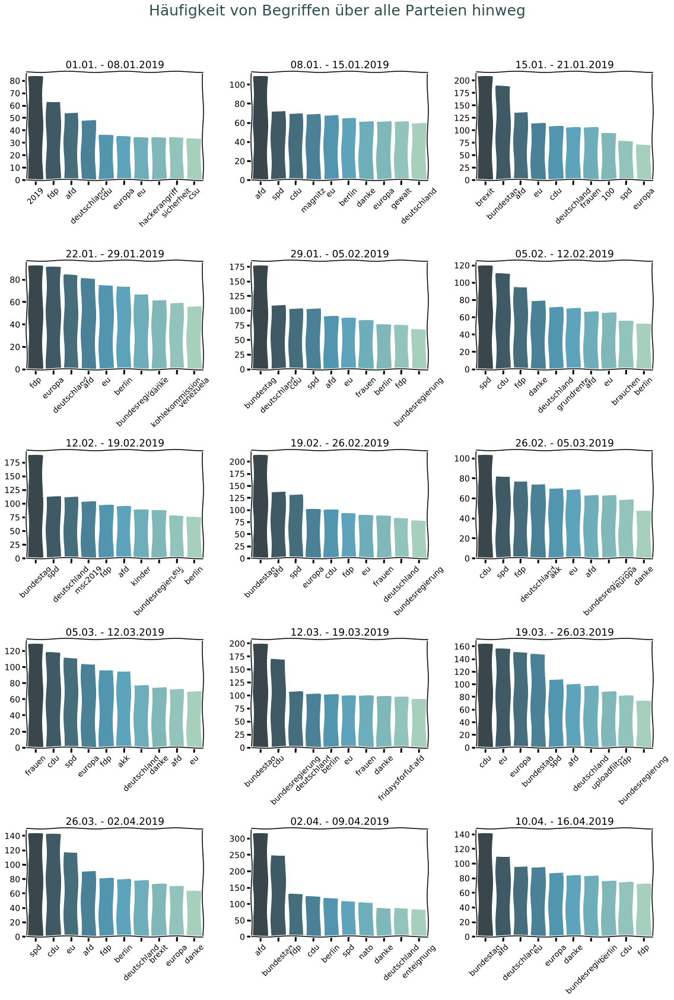

In [151]:
# Load the library with the CountVectorizer method
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

# Helper function
def plot_10_most_common_words(count_data, count_vectorizer, title):
    import matplotlib.pyplot as plt
    words = count_vectorizer.get_feature_names()
    total_counts = np.zeros(len(words))
    for t in count_data:
        total_counts+=t.toarray()[0] # total_counts = total_counts + t.toarray
    
    count_dict = (zip(words, total_counts))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:10]
    words = [w[0] for w in count_dict]
    counts = [w[1] for w in count_dict]
    x_pos = np.arange(len(words))
    
    with plt.xkcd():
        ax = fig.add_subplot(5,3,n, title =  title)
        fig.tight_layout()
        ax = sns.barplot(x_pos, counts, palette="GnBu_d")
        ax.set_xticklabels(words, rotation = 45, fontsize=13)
        return ax

    
# Initialise the count vectorizer with the german stop words
count_vectorizer = CountVectorizer(stop_words=stop_words)


fig = plt.figure(figsize = (16, 22))
for i, n in zip(weeks, range(1,16)):
    title = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
    
    # Fit and transform the processed titles
    count_data = count_vectorizer.fit_transform(weeks[i]['full_text_processed'])
    plot_10_most_common_words(count_data, count_vectorizer, title)
    
fig.suptitle('Häufigkeit von Begriffen über alle Parteien hinweg', fontsize=25, color='darkslategray', y=1.05)
plt.show()


# Sentiment Analyse - Wörterbuch
## Simple TextBlob Analysis

In [43]:
#import nltk
#nltk.download('punkt')
from textblob_de import TextBlobDE as TextBlob

blob = TextBlob(sample_df.full_text_processed[33504]) 

# print(blob.sentences)
# print(blob.tokens)
# print(blob.tags)
# print(blob.noun_phrases)
print(blob.sentiment)

Sentiment(polarity=0.0, subjectivity=0.0)


In [44]:
# https://medium.com/@himanshu_23732/sentiment-analysis-with-textblob-6bc2eb9ec4ab
def sentiment(text):
    try:
        return TextBlob(text).sentiment
    except:
        return None
    
sample_df['Polarity']     = sample_df['full_text_processed'].apply(sentiment).apply(lambda x: x[0])
sample_df['Subjectivity'] = sample_df['full_text_processed'].apply(sentiment).apply(lambda x: x[1])
sample_df.head()

,_id,created_at,id,full_text,is_quote_status,retweet_count,lang,created_at_datetime,user_id,user_name,...,user_location,user_description,user_followers_count,user_friends_count,user_created_at,user_party,bins,full_text_processed,Polarity,Subjectivity
160213,5eb77f3a4f4fda7c5d6242fa,Sun Jan 01 00:42:42 +0000 2017,815357545942515712,Frohes neues Jahr #2017\nhttps://t.co/9LhBEbmMEH,False,0,de,2017-01-01 00:42:42,23248102,Cansel Kiziltepe,...,Berlin,"Ökonomin, Politikerin #MdB @spdbt #berlin #xhain #spdxhain #PBerg #wk83 #KiezkindCansel #kiezregiert",6312,1421,Sat Mar 07 23:27:23 +0000 2009,SPD,1,Frohes neues Jahr 2017,1.00,0.0
204397,5eb791a12c0dd47b69080836,Sun Jan 01 08:14:50 +0000 2017,815471330057474048,"Hätte gewünscht, dass #2017 besser startet als #2016 #Istanbul @SenyurtSinan. Gedanken bei den Opfern! #üzgüngece",False,1,de,2017-01-01 08:14:50,22125770,Ekin Deligöz,...,,MdB @GrueneBundestag aus #Neu_Ulm | Sprecherin der Bayrischen Landesgruppe | Mitglied #Haushaltsausschuss | Obfrau #Rechnungsprüfungsausschuss,7666,1297,Fri Feb 27 09:59:05 +0000 2009,Gruene,1,Hätte gewünscht dass 2017 besser startet als 2016 Istanbul SenyurtSinan Gedanken bei den Opfern üzgüngece,0.00,0.0
98687,5e95a104dc45db2183f9ea3f,Sun Jan 01 09:14:16 +0000 2017,815486287104851968,Alles Gute im neuen Jahr! Das Wahljahr beginnt für mich um 11 Uhr bei der CDU Korntal im Bürgertreff in der Görlitzstraße. Herzl. Einladung!,False,0,de,2017-01-01 09:14:16,23925041,Steffen Bilger,...,Ludwigsburg / Berlin,"MdB Wahlkreis Ludwigsburg, Parlamentarischer Staatssekretär im @BMVI, Vorsitzender CDU Nordwürttemberg",4777,771,Thu Mar 12 09:30:05 +0000 2009,Union,1,Alles Gute im neuen Jahr Das Wahljahr beginnt für mich um 11 Uhr bei der CDU Korntal im Bürgertreff in der Görlitzstraße Herzl Einladung,0.00,0.0
334061,5ed76f53a196a3b4575d6043,Sun Jan 01 09:14:37 +0000 2017,815486374086381572,https://t.co/sJoSZUueUc,False,0,und,2017-01-01 09:14:37,46498076,Mathias_Stein,...,,"Bundestagsabgeordneter (SPD) aus Kiel, Mitglied im Verkehrsausschuss #Radverkehr #EMobilität #Binnenschifffahrt",1402,932,Thu Jun 11 21:36:58 +0000 2009,SPD,1,,0.00,0.0
107580,5e95a302dc45db2183fb82fc,Sun Jan 01 09:38:05 +0000 2017,815492279398006784,Alles Gute im neuen Jahr! https://t.co/4pbjFX0QVm,False,0,de,2017-01-01 09:38:05,368334555,Patrick Schnieder,...,Arzfeld/Eifel,"Bundestagsabgeordneter, Parlamentarischer Geschäftsführer der CDU/CSU-Bundestagsfraktion, direkt gewählt im Wahlkreis 202 Bitburg",4062,1052,Mon Sep 05 13:31:39 +0000 2011,Union,1,Alles Gute im neuen Jahr,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
379458,5ed773e40af7ab1cc988656f,Wed Jun 03 09:44:42 +0000 2020,1268116388075450370,@fuchsgruen @KlaraSche @HinrichWe War wie immer schön mit Euch :-) 👏👏👏,False,0,de,2020-06-03 09:44:42,569166756,Lisa Paus,...,Charlottenburg-Wilmersdorf,"@GrueneBundestag Sprecherin für Finanzpolitik, Feministin 💜 Mama 👩‍👦 Grüne 🌻 🇪🇺 #Greenfinance #taxjustice #Immobilienspekulation #Geldwäsche",8120,1970,Wed May 02 12:57:06 +0000 2012,Gruene,70,fuchsgruen KlaraSche HinrichWe War wie immer schön mit Euch - 👏👏👏,1.00,0.0
372432,5ed7735c7a23e3b2cd610790,Wed Jun 03 09:47:17 +0000 2020,1268117042189807616,"Wer Millionen Muslime im eigenen Land einsperrt, sollte sich mit Ratschlägen zu Menschenrechten zurückhalten. https://t.co/bFAaCQfj7i",True,0,de,2020-06-03 09:47:17,17535941,Christian Dürr,...,Berlin / Ganderkesee,"Fraktions-Vize bei der @fdpbt, zuständig für Haushalt & Finanzen",3929,1050,Fri Nov 21 13:20:23 +0000 2008,FDP,70,Wer Millionen Muslime im eigenen Land einsperrt sollte sich mit Ratschlägen zu Menschenrechten zurückhalten,1.00,0.0
383807,5ed774567a23e3b2cd615e58,Wed Jun 03 09:49:34 +0000 2020,1268117615551053827,Italienische Corona App läuft sogar auf Deutsch. Die aus ihrer CDU /SPD Bundesregierung nicht. Zu lahm! https://t.co/VkqvFGQpi9 https://t.co/nTbp5CqcSy,True,1,de,2020-06-03 09:49:34,1085494381405237251,Dr. forest Christoph Hoffmann,...,"

In [45]:
# compute sentiment scores (polarity) and labels
sentiment_scores = sample_df['Polarity']
sentiment_category = ['positive' if score > 0 
                             else 'negative' if score < 0 
                                 else 'neutral' 
                                     for score in sentiment_scores]


# sentiment statistics per news category
df_weeks = pd.DataFrame([list(sample_df['bins']), list(sample_df['user_party']), list(sentiment_scores), list(sentiment_category)]).T
df_weeks.columns = ['bins', 'partei', 'sentiment_score', 'sentiment_category']
df_weeks['sentiment_score'] = df_weeks.sentiment_score.astype('float')
df_weeks.groupby(by=['partei']).describe()

sentiment_score                                                  
                 count      mean       std  min  25%  50%       75%  max
partei                                                                  
AFD     46247.0         0.084745  0.548325 -1.0  0.0  0.0  0.466667  1.0
FDP     67310.0         0.154663  0.523485 -1.0  0.0  0.0  0.700000  1.0
Gruene  74482.0         0.168855  0.523026 -1.0  0.0  0.0  0.700000  1.0
Linke   63629.0         0.100430  0.536506 -1.0  0.0  0.0  0.500000  1.0
SPD     86843.0         0.227314  0.508437 -1.0  0.0  0.0  0.700000  1.0
Union   73655.0         0.225697  0.516635 -1.0  0.0  0.0  0.700000  1.0

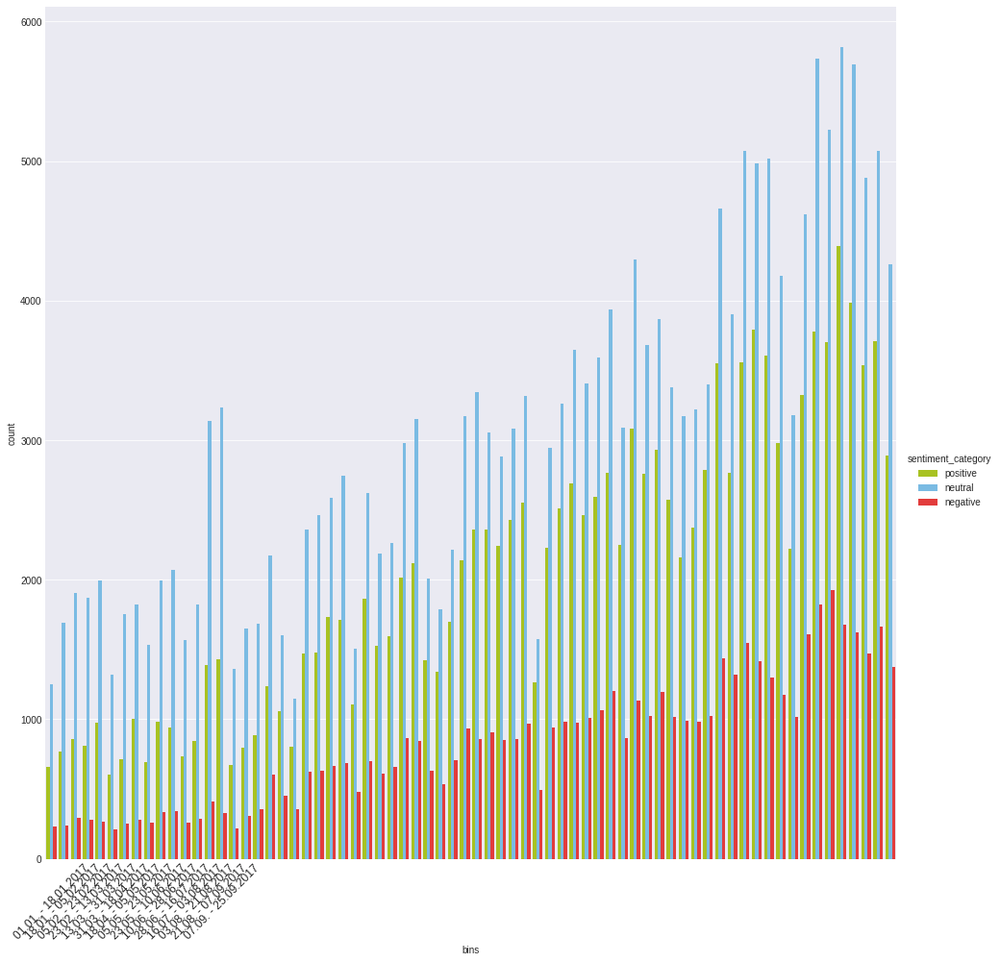

In [46]:
import matplotlib.pyplot as plt
import seaborn as sns

labels = []


for i, n in zip(weeks, range(1,16)):
    label = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
    labels.append(label)
    
ax = sns.catplot(x="bins", hue="sentiment_category", height=13,
                    data=df_weeks, kind="count", 
                    palette={"negative": "#FE2020", 
                             "positive": "#BADD07", 
                             "neutral": "#68BFF5"})
ax.set_xticklabels(labels, rotation = 45, fontsize=12)

#print(labels)

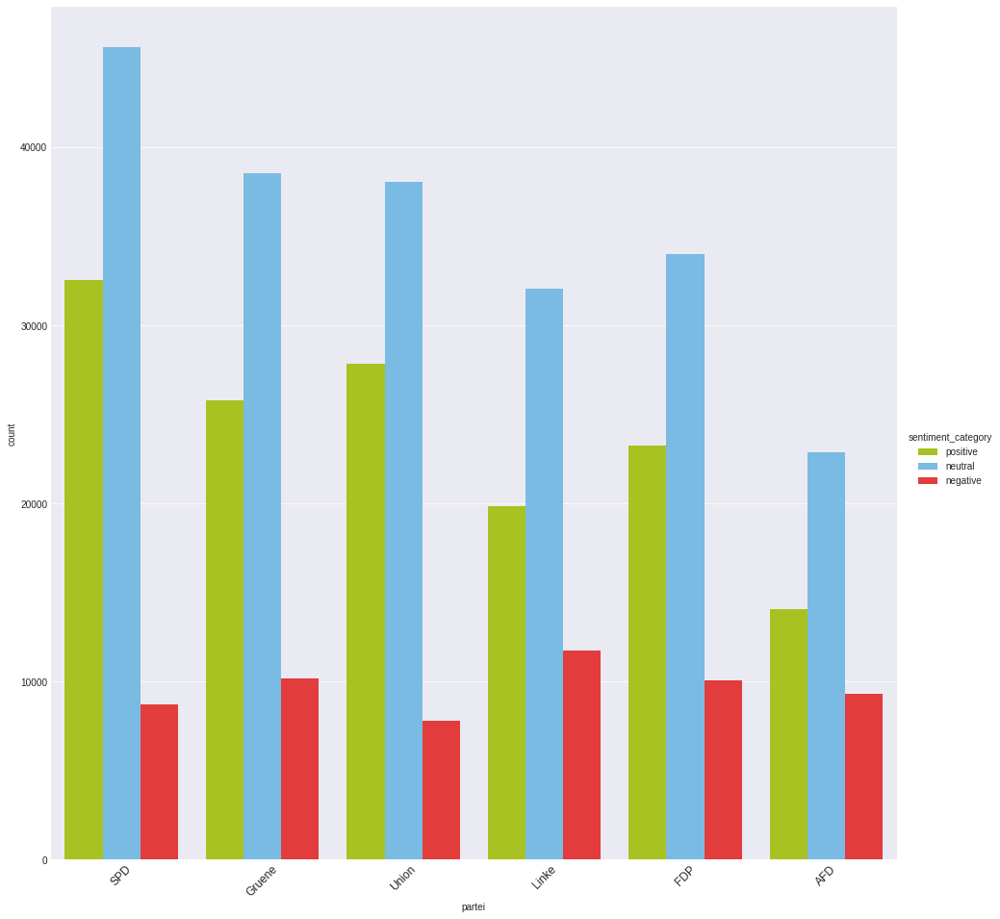

In [47]:
ax = sns.catplot(x="partei", hue="sentiment_category", height=13,
                    data=df_weeks, kind="count", 
                    palette={"negative": "#FE2020", 
                             "positive": "#BADD07", 
                             "neutral": "#68BFF5"})
ax.set_xticklabels(rotation = 45, fontsize=12)

Text(0.5, 1.05, 'Häufigkeit von von pos, neg und neut Tweets nach Parteien')

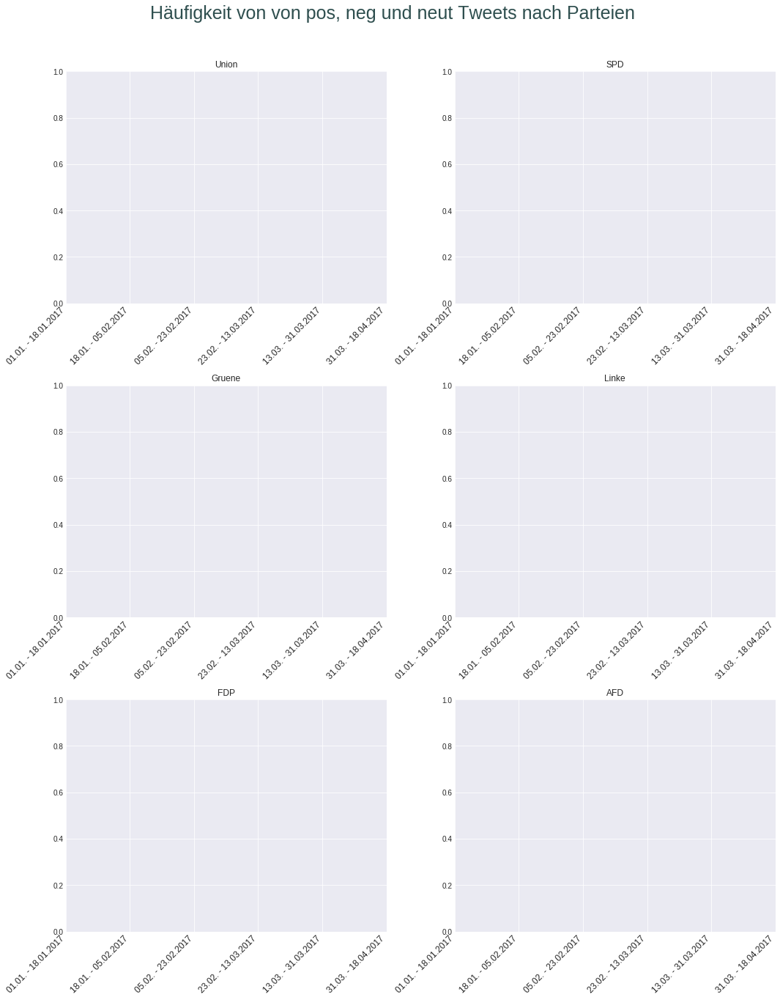

In [50]:
partei_dic_sent = {}
for partei in parteien:
    partei_dic_sent['sentiment_'+ partei] = df_weeks[df_weeks['partei'] == partei]  
    
for i, n in zip(weeks, range(1,16)):
    label = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
    labels.append(label)

fig = plt.figure(figsize = (15, 18))

for partei, n in zip(parteien, range(1,7)):
    ax = fig.add_subplot(3,2,n, title = partei)
    fig.tight_layout()
    sns.catplot(x="bins", hue="sentiment_category", data=partei_dic_sent['sentiment_'+partei], kind="count", palette={"negative": "#FE2020", "positive": "#BADD07", "neutral": "#68BFF5"}, ax=ax)
    ax.set_xticklabels(labels, rotation = 45, fontsize=12, ha='right')
    plt.close(2)
    
fig.suptitle('Häufigkeit von von pos, neg und neut Tweets nach Parteien', fontsize=25, color='darkslategray', y=1.05)

## Basic Emotions

In [10]:
import pandas as pd
from nltk import word_tokenize
from nltk.stem.snowball import SnowballStemmer
from tqdm import tqdm


import csv
import numpy as np
import pandas as pd

pd.set_option('display.max_colwidth', 0)
    
######### Erstelle Emotions-Matrix

filepath = '/home/lisa/Darmstadt/Master Arbeit/06_Analyse/Lexicon_based/german-emotion-dictionary/fundamental/'
emo_df = []
words = []
emotion = ['Ekel', 'Freude', 'Furcht', 'Trauer', 'Ueberraschung', 'Verachtung', 'Wut']
emotion_list= {}
stemmer = SnowballStemmer("german")

for emo in emotion:
    with open(filepath + emo + '.txt', newline='\n') as f:
        reader = csv.reader(f)
        data = [item for sublist in reader for item in sublist] 
        emotion_list[str(emo)] = data
        words.extend(data)
        
words = list(set(words)) # remove Duplicates which come from overlapping EmotionLists
emo_df  = pd.DataFrame(index=words, columns=emotion)

words = []
for word in emo_df.index:
    for emo in emo_df.columns:
        if word in emotion_list[emo]:
            emo_df.at[word, emo] = 1
        else:
            emo_df.at[word, emo] = 0
    words.append(stemmer.stem(word.lower()))
 
emo_df.index= words
emo_df = emo_df.sort_index(ascending=True)
emo_df = pd.DataFrame(emo_df)
emo_df = emo_df.loc[~emo_df.index.duplicated(keep='first')]

emo_df.head()


,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut
aalglatt,0,0,0,0,0,1,0
aasgei,0,0,0,0,0,1,0
abbrech,0,0,0,1,0,0,0
abbruchreif,0,0,0,0,0,1,0
abbugeln,0,0,0,0,0,1,0


In [ ]:
# print_debug = False
# def debug(string):
#     if print_debug == True:
#         print(string)

# for word in emo_df.index:
#      debug("'%s'" % (word))
#      debug(type(word))
#      #for emo in emotion_list:
#      for emo in emo_df.columns:
#          #print(emo)
#          #print(type(emo))
#          if word in emotion_list[emo]:
#              debug("Word '%s' is of emotion: '%s'" % (word, emo))
#              #print(emo_df[emo][word])
#              #print(emo_df.columns)
#              #print(emo_df.ix[1])
#              emo_df.at[word, emo] = 1
#              debug(emo_df.loc[word])
#              debug("\n")

#          #else:
#          #    emo_df.at[str(emo)][word] = 0

# emo_df[1:12]

In [11]:
#from fuzzywuzzy import fuzz
emo_base_df = sample_df['full_text_processed']
df_emo = pd.DataFrame(0, index=emo_base_df.index, columns=emotion)

for i in emo_base_df.index:
    document = word_tokenize(emo_base_df.loc[i])
    for word in document:
        word = stemmer.stem(word.lower())             # Stemming des einzelnen Wortes aus Tweet um es...
        emo_score = emo_df[emo_df.index == word]      # ... mit den Lexikon Worten zu vergleichen -> emo_score 

#         for w in emo_df.index:
#             fuz = fuzz.ratio(str(w), word)
#             if fuz > 98:
#                 emo_score = emo_df[emo_df.index == w].drop_duplicates(keep = 'first')    

        if not emo_score.empty:                       # der emo score eines Worts z.B. [0 0 1 1 0 0 0] 
            for emot in emotion:                      # wird zum Score des Tweets dazugezählt z.B.: [2 0 4 1 0 0 0]
                df_emo.at[i, emot] += emo_score[emot] # am Ende exisitiert zu einem Tweet 
                

emo_base_df = pd.concat([emo_base_df, df_emo], axis=1)

emo_base_df.head(20)

,full_text_processed,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut
160213,Frohes neues Jahr 2017,0,1,0,0,1,0,0
204397,Hätte gewünscht dass 2017 besser startet als 2016 Istanbul SenyurtSinan Gedanken bei den Opfern üzgüngece,0,0,0,0,0,0,0
98687,Alles Gute im neuen Jahr Das Wahljahr beginnt für mich um 11 Uhr bei der CDU Korntal im Bürgertreff in der Görlitzstraße Herzl Einladung,0,1,0,0,1,0,0
333391,,0,0,0,0,0,0,0
107580,Alles Gute im neuen Jahr,0,1,0,0,1,0,0
111781,Traurig zu hören dass das neue Jahr mit Anschlag in Istanbul beginnen muss Unsrer Gedanken sind bei den Menschen dort Reina,0,0,1,1,1,0,0
286207,,0,0,0,0,0,0,0
272874,Terroranschlag von Istanbul überschattet Neujahr Trauer mit Opfern Unser Entsetzen Ziel des Täters Zusammenhalt u Frieden stärker,0,2,1,1,1,0,0
86951,Der abscheuliche Terroranschlag von Istanbul überschattet Neujahr Unsere Gedanken sind bei den Opfern und ihren Familien+Freunden reina,1,0,0,0,0,0,0
337799,RotkreuzRetter Gut dass es relativ ruhig blieb Danke für das Gespräch gestern Abend und die interesssnten Infos über Ihre Arbeit,0,1,0,0,0,0,0


In [13]:
#### Add Timestamp
# -> In Grafiken später mit abgebildet

emo_base_df['Partei'] = sample_df['user_party']
emo_base_df['created_at_datetime'] = sample_df['created_at_datetime']
emo_base_df.head(20)

,full_text_processed,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut,Partei,created_at_datetime
160213,Frohes neues Jahr 2017,0,1,0,0,1,0,0,SPD,2017-01-01 00:42:42
204397,Hätte gewünscht dass 2017 besser startet als 2016 Istanbul SenyurtSinan Gedanken bei den Opfern üzgüngece,0,0,0,0,0,0,0,Gruene,2017-01-01 08:14:50
98687,Alles Gute im neuen Jahr Das Wahljahr beginnt für mich um 11 Uhr bei der CDU Korntal im Bürgertreff in der Görlitzstraße Herzl Einladung,0,1,0,0,1,0,0,Union,2017-01-01 09:14:16
333391,,0,0,0,0,0,0,0,SPD,2017-01-01 09:14:37
107580,Alles Gute im neuen Jahr,0,1,0,0,1,0,0,Union,2017-01-01 09:38:05
111781,Traurig zu hören dass das neue Jahr mit Anschlag in Istanbul beginnen muss Unsrer Gedanken sind bei den Menschen dort Reina,0,0,1,1,1,0,0,Union,2017-01-01 09:51:49
286207,,0,0,0,0,0,0,0,SPD,2017-01-01 10:23:48
272874,Terroranschlag von Istanbul überschattet Neujahr Trauer mit Opfern Unser Entsetzen Ziel des Täters Zusammenhalt u Frieden stärker,0,2,1,1,1,0,0,SPD,2017-01-01 10:32:28
86951,Der abscheuliche Terroranschlag von Istanbul überschattet Neujahr Unsere Gedanken sind bei den Opfern und ihren Familien+Freunden reina,1,0,0,0,0,0,0,SPD,2017-01-01 10:45:24
337799,RotkreuzRetter Gut dass es relativ ruhig blieb Danke für das Gespräch gestern Abend und die interesssnten Infos über Ihre Arbeit,0,1,0,0,0,0,0,SPD,2017-01-01 10:48:13


In [15]:
emo_base_select = emo_base_df[emo_base_df['full_text_processed'].str.match(r'.*((?i)corona|(?i)Covid).*')==True]
len(emo_base_select[emo_base_select['Partei']=='Gruene'])
#len(emo_base_select)

2231

In [16]:
### Remove empty full_text_processed
# -> Wenn z.B. nur ein Link und emojis gepostet wurden ist nach dem text cleaning die Zelle leer (aber nicht isnull() == true)
# sample_df[sample_df.created_at_datetime == datetime.datetime(2020,2,1,7,26,32)]

#emo_base_text = emo_base_df.drop(emo_base_df[emo_base_df['full_text_processed']==''].index)
emo_base_text = emo_base_df.drop(emo_base_select[emo_base_select['full_text_processed']==''].index)
emo_base_text = emo_base_text.drop(emo_base_text[emo_base_text['full_text_processed']==' '].index)
emo_base_text = emo_base_text.drop(emo_base_text[emo_base_text['full_text_processed']=='  '].index)
emo_base_text = emo_base_text.drop(emo_base_text[emo_base_text['full_text_processed']=='   '].index)
#emo_base_text[emo_base_text['full_text_processed']=='']

In [17]:
emo_party = emo_base_text.groupby('Partei').sum()
emo_party.head()

,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut
Partei,,,,,,,
AFD,1101,13047,7304,6559,5014,14023,3753
FDP,1141,19184,6327,9539,7955,14697,3198
Gruene,1396,25095,7342,9717,9149,13908,3789
Linke,1431,18039,8898,9130,6704,17757,3969
SPD,1424,34660,7683,9880,8665,13116,3890


In [18]:
#### Relative Werte
# 1.) Teilen durch Wordcount pro Tweet

from nltk import tokenize
from nltk import word_tokenize

emo_base_rel=emo_base_text

emo_base_rel['word_count'] = emo_base_rel['full_text_processed'].apply(tokenize.word_tokenize).apply(len)

for emo in emotion:
    emo_base_rel[emo] = emo_base_rel[emo] / emo_base_rel['word_count']
emo_base_rel.head()

,full_text_processed,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut,Partei,created_at_datetime,word_count
160213,Frohes neues Jahr 2017,0.0,0.250000,0.0,0.0,0.250000,0.0,0.0,SPD,2017-01-01 00:42:42,4
204397,Hätte gewünscht dass 2017 besser startet als 2016 Istanbul SenyurtSinan Gedanken bei den Opfern üzgüngece,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,Gruene,2017-01-01 08:14:50,15
98687,Alles Gute im neuen Jahr Das Wahljahr beginnt für mich um 11 Uhr bei der CDU Korntal im Bürgertreff in der Görlitzstraße Herzl Einladung,0.0,0.041667,0.0,0.0,0.041667,0.0,0.0,Union,2017-01-01 09:14:16,24
333391,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,SPD,2017-01-01 09:14:37,0
107580,Alles Gute im neuen Jahr,0.0,0.200000,0.0,0.0,0.200000,0.0,0.0,Union,2017-01-01 09:38:05,5


In [ ]:
# 2.) Teilen durch Gesammtzahl an Tweets pro Partei #### bringt nicht die richtigen Ergebnisse

# emo_party_rel_0 = emo_base_rel.groupby('Partei').sum().apply(lambda x: x/float(x.count()))
# emo_party_rel_0.head()

In [19]:
# 2.) Teilen durch Gesammtzahl an Tweets pro Partei #### umständliche aber korrekte Version
emo_party_sum = emo_base_rel.groupby('Partei').sum()
emo_party_count = emo_base_rel.groupby('Partei').count()
emo_party_rel_1 = emo_party_sum/ emo_party_count
emo_party_rel_1

,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut,created_at_datetime,full_text_processed,word_count
Partei,,,,,,,,,,
AFD,0.001107,0.014728,0.006709,0.006427,0.005587,0.013957,0.003527,NaN,NaN,21.770174
FDP,0.000763,0.016047,0.003968,0.006877,0.005597,0.010300,0.001970,NaN,NaN,21.402578
Gruene,0.000940,0.021429,0.004293,0.006051,0.006332,0.008954,0.002208,NaN,NaN,20.674842
Linke,0.001135,0.015980,0.005943,0.006332,0.005278,0.012996,0.002637,NaN,NaN,22.095118
SPD,0.000885,0.028737,0.003772,0.005518,0.005678,0.007832,0.001974,NaN,NaN,19.151169
Union,0.000765,0.025716,0.003373,0.005158,0.006171,0.008743,0.001874,NaN,NaN,19.429683


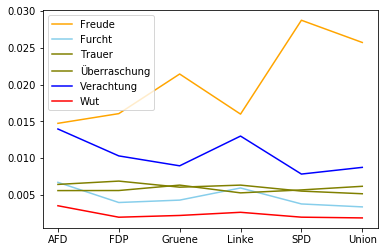

In [20]:
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# fig = plt.figure(figsize = (15, 18))
   
    
# ax = sns.catplot(x=emo_party_rel_1.index, hue=emo_party_rel_1.columns[1:7], height=13,
#                     data=emo_party_rel_1, kind="bar", 
#                     palette='GnBu_d')
# ax.set_xticklabels(rotation = 45, fontsize=12)
# #fig.suptitle('Häufigkeit von von pos, neg und neut Tweets nach Parteien', fontsize=25, color='darkslategray', y=1.05)

# for emo in emotion:
#     fig, ax = plt.subplots()
#     ax.scatter(emo_base_rel.index,emo_base_rel[emo])

# plt.show()

# for emo in emotion:
#     fig, ax = plt.subplots()
#     ax.scatter(emo_party_rel_1.index,emo_party_rel_1[emo])

# plt.show()

plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[1], data=emo_party_rel_1, color='orange')
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[2], data=emo_party_rel_1, color='skyblue')
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[3], data=emo_party_rel_1, color='olive')
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[4], data=emo_party_rel_1, color='olive',label="Überraschung")
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[5], data=emo_party_rel_1, color='blue')
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[6], data=emo_party_rel_1, color='red')
plt.legend()


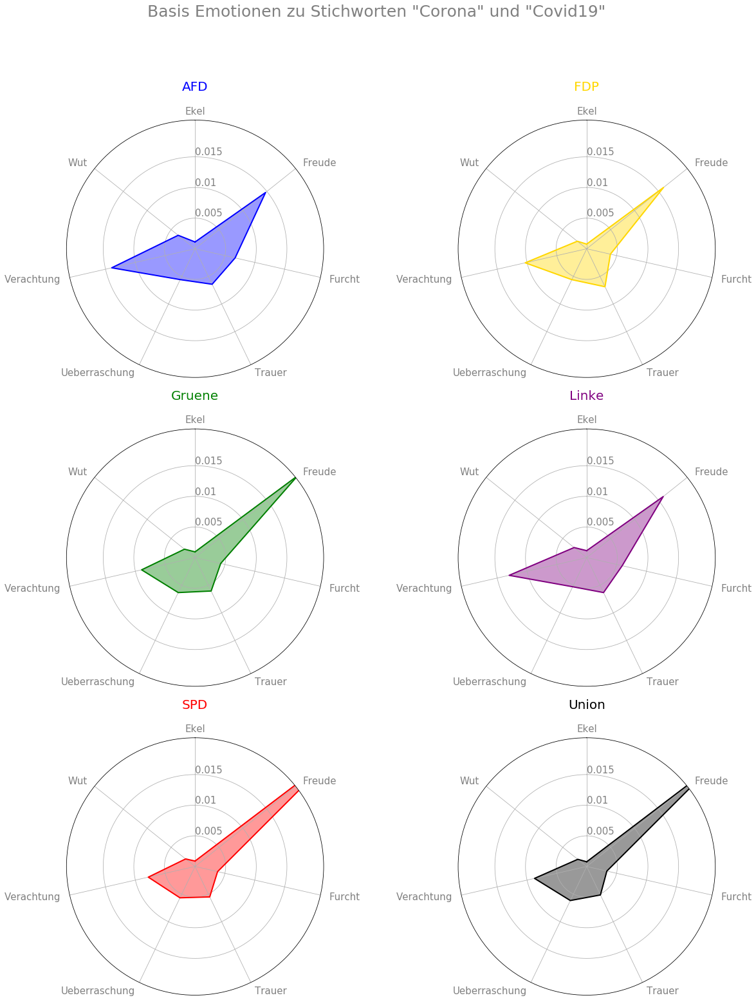

In [21]:
## https://python-graph-gallery.com/392-use-faceting-for-radar-chart/
# Libraries
import matplotlib.pyplot as plt
import pandas as pd
from math import pi
 
# ------- PART 1: Define a function that do a plot for one line of the dataset!
 
def make_spider(row, title, color):
    # number of variable
    categories=list(df)[0:]
    N = len(categories)
 
    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
 
    # Initialise the spider plot
    ax = plt.subplot(3,2,row+1, polar=True, )

    # If you want the first axis to be on top:
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)

    # Draw one axe per variable + add labels labels yet #https://www.pythoncharts.com/2019/04/16/radar-charts/
    plt.xticks(angles[:-1], categories, color='grey', size=15)
    for label, angle in zip(ax.get_xticklabels(), angles):
        if angle in (0, np.pi):
            label.set_horizontalalignment('center')
        elif 0 < angle < np.pi:
            label.set_horizontalalignment('left')
        else:
            label.set_horizontalalignment('right')
 
    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([0.005,0.01,0.015], ['0.005','0.01','0.015'], color="grey", size=15)
    plt.ylim(0,0.021)

    # Ind1
    values=df.loc[df.index[row]].values.flatten().tolist()
    values += values[:1]
    ax.plot(angles, values, color=color, linewidth=2, linestyle='solid')
    ax.fill(angles, values, color=color, alpha=0.4)

    # Add a title
    plt.title(title, size=20, color=color, y=1.1)
 

# ------- PART 2: Apply to all individuals
# initialize the figure

df=emo_party_rel_1[emo_party_rel_1.columns[0:7]]

fig = plt.figure(figsize=(20, 25))
fig.tight_layout()
fig.suptitle('Basis Emotionen zu Stichworten "Corona" und "Covid19" ', color="grey", size=25)
 
# Create a color palette:
my_palette = plt.cm.get_cmap("Set2", len(df.index))
my_palette = ['blue', 'gold', 'green', 'purple', 'red', 'black']
 
# Loop to plot
for row in range(0, len(df.index)):
    make_spider( row=row, title=df.index[row], color=my_palette[row])

In [ ]:
values=df.loc[df1.index[row]].values.flatten().tolist()
values += values[:1]
values

In [ ]:
df.loc[df1.index[row]]